Purpose of this file

Try out different audio preprocessing techniques and tinker around with them

In [11]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio
from sklearn.preprocessing import minmax_scale

In [12]:
# loading an example audio file from librosa
y, sr = librosa.load(librosa.example("fishin"))

In [13]:
from IPython.display import Audio
Audio(y, rate=sr)

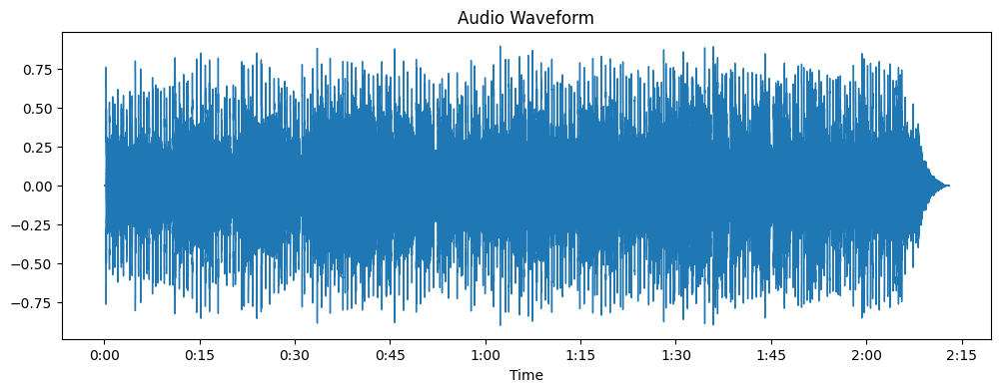

In [14]:
# Plot the waveform
plt.figure(figsize=(12, 4))
librosa.display.waveshow(y, sr=sr)
plt.title('Audio Waveform')
plt.show()

In [15]:
y_normalized = minmax_scale(y)

In [17]:
Audio(y_normalized, rate=sr)

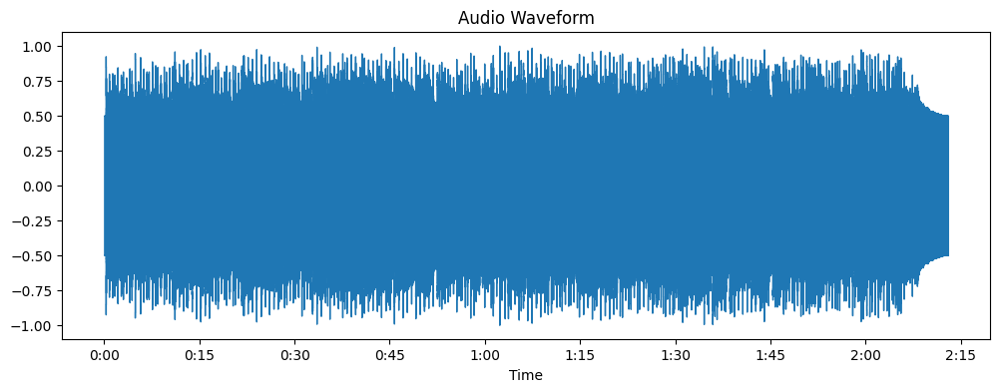

In [16]:
# Plot the normalized waveform
plt.figure(figsize=(12, 4))
librosa.display.waveshow(y_normalized, sr=sr)
plt.title('Audio Waveform')
plt.show()

From the two images above we can the difference between a normalized waveform and unnormalized waveform

In [20]:
# Resamping is basically loading the audio files with a certain sampling rate
y, sr = librosa.load(librosa.example("fishin"), sr=45000)

In [21]:
# noise reduction
import soundfile as sf
import noisereduce as nr 

data, samplerate = sf.read(librosa.example("fishin"))

y_reduced_noise = nr.reduce_noise(y=data, sr=samplerate)

Audio(y_reduced_noise, rate=samplerate)

c:\Users\Vishal\Github\Audio-Processing\venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [23]:
# filtering
import numpy as np
import scipy.signal as signal

# low pass filter
def low_pass_filter(y, sr, cutoff):
    b, a = signal.butter(4, cutoff/ (sr/2), btype="low")
    return signal.filtfilt(b, a, y)

def high_pass_filter(y ,sr, cutoff):
    b, a = signal.butter(4, cutoff / (sr / 2), btype="high")
    return signal.filtfilt(b, a, y)

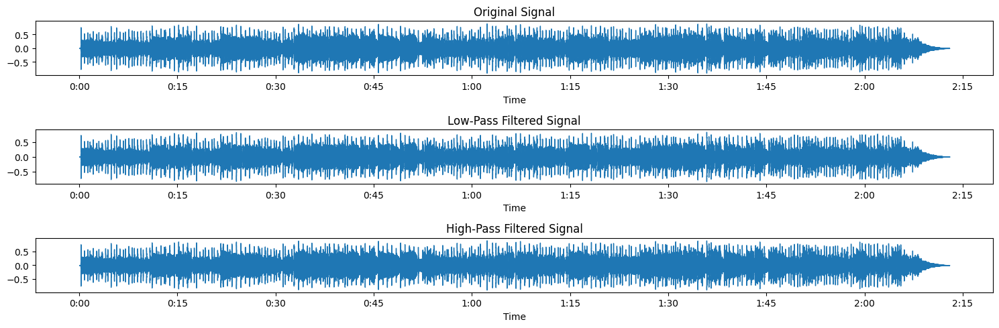

In [26]:
# Load the example audio
y, sr = librosa.load(librosa.example("fishin"))

# Apply low-pass filter (e.g., cutoff at 1000 Hz)
y_low_pass = low_pass_filter(y, sr, cutoff=1500)

# Apply high-pass filter (e.g., cutoff at 20 Hz)
y_high_pass = high_pass_filter(y, sr, cutoff=10)

# Visualize the results
plt.figure(figsize=(15, 5))

plt.subplot(3, 1, 1)
librosa.display.waveshow(y, sr=sr)
plt.title('Original Signal')

plt.subplot(3, 1, 2)
librosa.display.waveshow(y_low_pass, sr=sr)
plt.title('Low-Pass Filtered Signal')

plt.subplot(3, 1, 3)
librosa.display.waveshow(y_high_pass, sr=sr)
plt.title('High-Pass Filtered Signal')

plt.tight_layout()
plt.show()
